Assignment
---------------

In [45]:
import numpy as np
import pandas as pd
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import scipy.stats as stats


In [46]:
df = pd.read_csv('weatherHistory.csv')

_____________________________________________________________
imformation about imported csv file
* This file contain 11 Features with 96,453 instances
__________________________________________________________

In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96453 entries, 0 to 96452
Data columns (total 12 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Formatted Date            96453 non-null  object 
 1   Summary                   96453 non-null  object 
 2   Precip Type               95936 non-null  object 
 3   Temperature (C)           96453 non-null  float64
 4   Apparent Temperature (C)  96453 non-null  float64
 5   Humidity                  96453 non-null  float64
 6   Wind Speed (km/h)         96453 non-null  float64
 7   Wind Bearing (degrees)    96453 non-null  float64
 8   Visibility (km)           96453 non-null  float64
 9   Loud Cover                96453 non-null  float64
 10  Pressure (millibars)      96453 non-null  float64
 11  Daily Summary             96453 non-null  object 
dtypes: float64(8), object(4)
memory usage: 8.8+ MB


__________________________________________________________________________________________________________________
I. a) Handle Missing Values and Outliers if any
------------------------------------------------------
*** IMPORTANT ***

About Data - 
weather report data that record  
- temperature
- Apparent Temperature
- Humidity
- Wind Speed
- Wind Bearing
- Visibility (km)
- Loud Cover,
- Pressure (millibars) 
for every hour for certain days

Use Case - simply we can tell ,the question (model) wants to predict 'Humidity' for given  'Apparent Temperature' . 
- ***Remove Formatted Date column*** => Considering model that 'Formatted Date' column not be useful for this particular use case
- ***Remove Daily Summary column*** => in the 'Daily Summery' column record overoll summery given day ( in the data 'Daily Summery' is same for every hour ), So, when processing with row data (for this use case)  'Daily Summery' column doese't make sense
- ***Remove Loud Cove***r => Loud Cover is 0 for every row 
_____________________________________________________________________________________________

In [48]:
#Removing 3 columns -  Formatted Date, Daily Summary,Loud Cover
df.drop(['Daily Summary','Loud Cover','Formatted Date'], axis = 1 , inplace=True)

In [49]:
df.isnull().sum()

Summary                       0
Precip Type                 517
Temperature (C)               0
Apparent Temperature (C)      0
Humidity                      0
Wind Speed (km/h)             0
Wind Bearing (degrees)        0
Visibility (km)               0
Pressure (millibars)          0
dtype: int64

In [50]:
df['Precip Type'].unique()

array(['rain', 'snow', nan], dtype=object)

  517 Precip Type data are missing  - that catergorical variable conatin rain or snow

<AxesSubplot:xlabel='Precip Type', ylabel='Temperature (C)'>

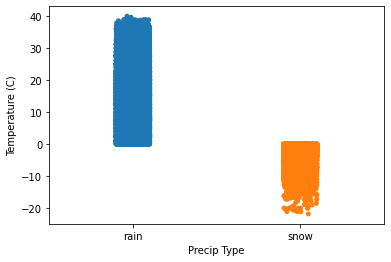

In [51]:
sns.stripplot(x='Precip Type',y='Temperature (C)',data=df)

from the plot graph clearly see rain snow depend on temparture , So fill the missing Percip Type accroding to temperature

In [52]:
# if ['Temperature (C)'] > 0 - rain 
# ['Temperature (C)'] <= 0  - snow
cond = df['Temperature (C)'] > 0
df['Precip Type'] = df['Precip Type'].fillna(cond.map({True:'rain', False: 'snow'}))
# now no null values in the df dataframe

In [53]:
perc =[.02,.20, .40, .60, .80,.90]
include =['object', 'float', 'int']
df.describe(percentiles = perc, include = include)

,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Pressure (millibars)
count,96453,96453,96453.000000,96453.000000,96453.000000,96453.000000,96453.000000,96453.000000,96453.000000
unique,27,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,Partly Cloudy,rain,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,31733,85741,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,11.932678,10.855029,0.734899,10.810640,187.509232,10.347325,1003.235956
std,NaN,NaN,9.551546,10.696847,0.195473,6.913571,107.383428,4.192123,116.969906
min,NaN,NaN,-21.822222,-27.716667,0.000000,0.000000,0.000000,0.000000,0.000000
2%,NaN,NaN,-5.605333,-9.116667,0.300000,0.515200,0.000000,0.386400,995.120000
20%,NaN,NaN,2.827778,0.483333,0.550000,4.701200,78.000000,7.084000,1010.684000
40%,NaN,NaN,8.844444,7.248889,0.720000,8.098300,158.000000,9.982000,1014.800000


in weather forcast context 'Humidity' and 'Pressure (millibars)' can not be zero ,  therefor considering that as contextual outliers.

In [54]:
hum_filter =  df['Humidity'] == 0 
pre_filter =  df['Pressure (millibars)'] == 0 
df.drop(index=df[hum_filter].index,inplace=True) 
df.drop(index=df[pre_filter].index,inplace=True) 

<ipython-input-54-8b278295ce7b>:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df.drop(index=df[pre_filter].index,inplace=True)


II)  Do transformations if required ?
--------------------------------------------------------------------------------

array([[<AxesSubplot:title={'center':'Temperature (C)'}>,
        <AxesSubplot:title={'center':'Apparent Temperature (C)'}>,
        <AxesSubplot:title={'center':'Humidity'}>],
       [<AxesSubplot:title={'center':'Wind Speed (km/h)'}>,
        <AxesSubplot:title={'center':'Wind Bearing (degrees)'}>,
        <AxesSubplot:title={'center':'Visibility (km)'}>],
       [<AxesSubplot:title={'center':'Pressure (millibars)'}>,
        <AxesSubplot:>, <AxesSubplot:>]], dtype=object)

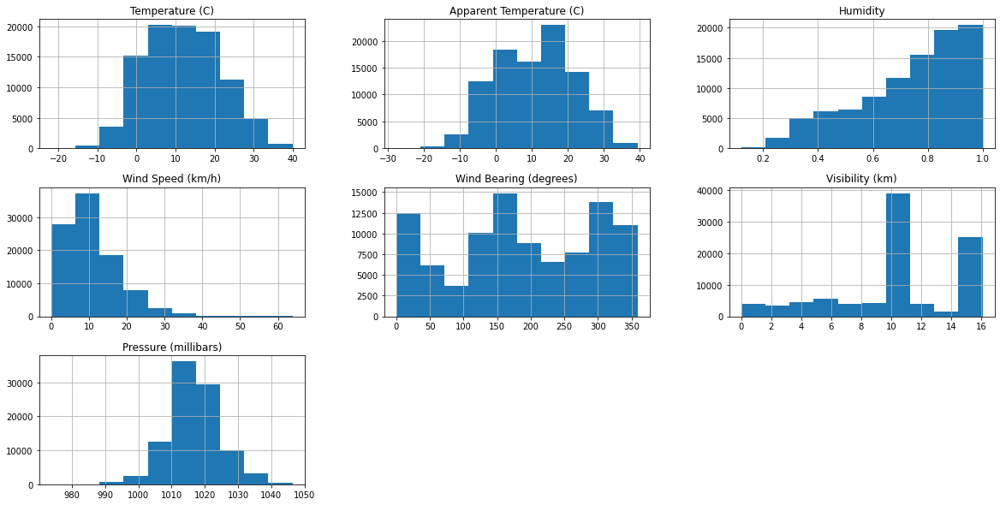

In [55]:
df.hist(alpha=1,figsize=(20, 10))

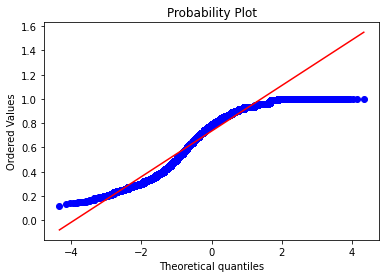

In [56]:
stats.probplot(df["Humidity"], dist="norm", plot=plt)
plt.show()

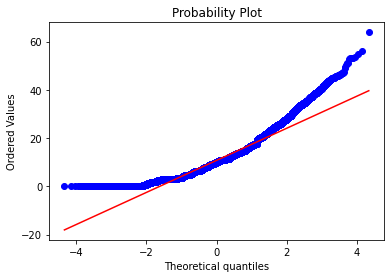

In [57]:
stats.probplot(df["Wind Speed (km/h)"], dist="norm", plot=plt)
plt.show()

_______________________________________________________
* Transformation need for *wind Speed* and *Hummidity*
_______________________________________________________


<AxesSubplot:>

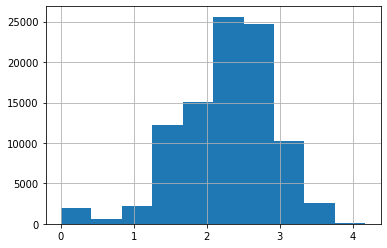

In [58]:
from sklearn.preprocessing import FunctionTransformer
log_transformer = FunctionTransformer(np.log,validate=True)
df['Wind Speed (km/h)'] = log_transformer.transform(df[['Wind Speed (km/h)']]+1)
df['Wind Speed (km/h)'].hist()

<AxesSubplot:>

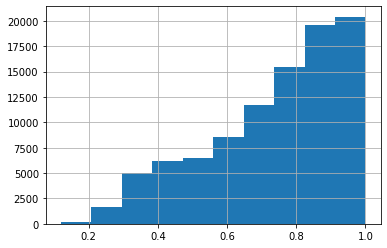

In [59]:
df['Humidity'].hist() 

<AxesSubplot:>

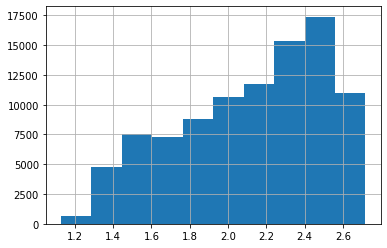

In [60]:
exponential_transformer = FunctionTransformer(np.exp)
df['Humidity'] = exponential_transformer.transform(df['Humidity'])
df['Humidity'].hist() 

_____________________________________________________________________
III) Apply suitable feature coding techniques
--------------------------------------------------

_______________________________________________________________
* copy Summary and Percip Type colums from Dataframe df
_______________________________________________________

In [61]:
df2 = pd.DataFrame([df['Summary'],df['Precip Type']]).transpose()

______________________________________________________________________
* Apply label encoding for ** Summary ** and ** Precip Type **
____________________________________________________________________

In [62]:
df2['Summary'] = df2['Summary'].astype('category').cat.codes
df2['Precip Type'] = df2['Precip Type'].astype('category').cat.codes

_________________________________________________________________________
* Droping categorical variabale column befor data Standerdization
_____________________________________________________________________

In [63]:
df.drop(['Summary','Precip Type'], axis = 1 , inplace=True)

__________________________________________________________________
==>  Standerize
* Temperature (C)
* Apparent Temperature (C)
*  Humidity
*  Wind Speed (km/h)
*  Wind Bearing (degrees)
*  Visibility (km)
*  Pressure (millibars)

In [64]:
cols =['Temperature (C)','Apparent Temperature (C)',
 'Humidity',
 'Wind Speed (km/h)',
 'Wind Bearing (degrees)',
 'Visibility (km)',
 'Pressure (millibars)']
scaler = StandardScaler() 
scaler.fit(df)
X_Scaled = scaler.transform(df)
X_Scaled_Except = pd.DataFrame(X_Scaled, columns=cols)
X_Scaled_Except.head()

,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Pressure (millibars)
0,-0.260291,-0.327397,0.804184,0.660723,0.591761,1.300415,-0.216237
1,-0.272521,-0.342484,0.618167,0.675135,0.666250,1.300415,-0.151938
2,-0.270192,-0.141141,0.804184,-1.033068,0.154138,1.092724,-0.112072
3,-0.384341,-0.462666,0.437647,0.659114,0.759361,1.300415,-0.051630
4,-0.335420,-0.365896,0.437647,0.317152,0.666250,1.300415,-0.038770


______________________________________________
After standardizing
_____________________________________________


array([[<AxesSubplot:title={'center':'Temperature (C)'}>,
        <AxesSubplot:title={'center':'Apparent Temperature (C)'}>,
        <AxesSubplot:title={'center':'Humidity'}>],
       [<AxesSubplot:title={'center':'Wind Speed (km/h)'}>,
        <AxesSubplot:title={'center':'Wind Bearing (degrees)'}>,
        <AxesSubplot:title={'center':'Visibility (km)'}>],
       [<AxesSubplot:title={'center':'Pressure (millibars)'}>,
        <AxesSubplot:>, <AxesSubplot:>]], dtype=object)

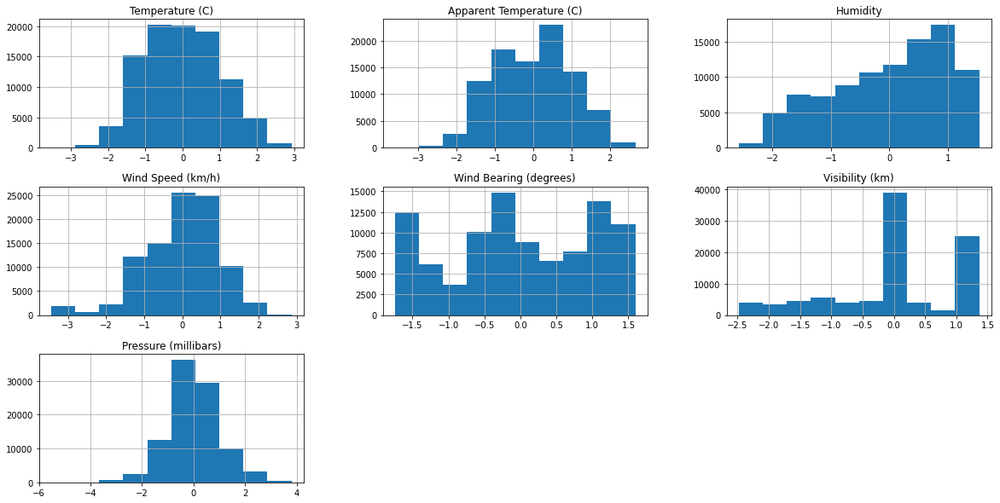

In [65]:
X_Scaled_Except.hist(alpha=1,figsize=(20, 10))

 ________________________________________________________________________
 *) Merging catergorical , numerical columns in to one Dataframe
 _____________________________________________________________________

In [66]:
merge = pd.concat([X_Scaled_Except, df2], axis=1)

In [67]:
merge.dropna(inplace=True)
merge.isnull().sum()

Temperature (C)             0
Apparent Temperature (C)    0
Humidity                    0
Wind Speed (km/h)           0
Wind Bearing (degrees)      0
Visibility (km)             0
Pressure (millibars)        0
Summary                     0
Precip Type                 0
dtype: int64

In [68]:
merge.describe()

,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Pressure (millibars),Summary,Precip Type
count,93833.000000,93833.000000,93833.000000,93833.000000,93833.000000,93833.000000,93833.000000,93833.000000,93833.000000
mean,0.001005,0.001017,-0.000110,-0.001441,-0.001672,-0.001194,0.001592,16.092270,0.112018
std,1.001716,1.001528,1.000389,1.000698,1.000451,1.001567,1.000860,4.278726,0.315390
min,-3.540916,-3.614962,-2.546351,-3.443113,-1.745331,-2.480346,-5.533838,0.000000,0.000000
25%,-0.758238,-0.800319,-0.780258,-0.551142,-0.674552,-0.480350,-0.602037,17.000000,0.000000
50%,0.010522,0.109627,0.148559,0.166483,-0.069329,-0.080351,-0.033626,18.000000,0.000000
75%,0.722790,0.745914,0.804184,0.659114,0.954895,1.081185,0.559219,19.000000,0.000000
max,2.930063,2.665177,1.536044,2.860898,1.597363,1.365800,3.802505,26.000000,1.000000


b) II .
---------------------
 Temperature and Apparent Temperature have high correlation therefor drop Temperature column from merge Dataframe
-------------------------------

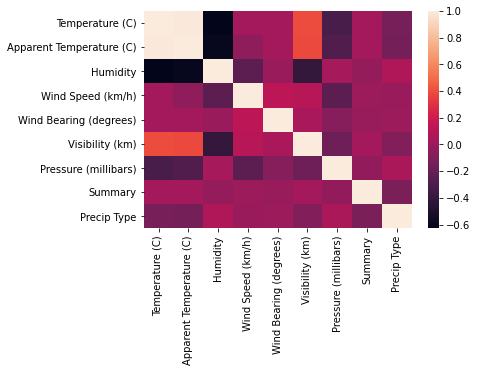

In [69]:
sns.heatmap(merge.corr());

In [70]:
merge.drop(['Temperature (C)'], axis = 1 , inplace=True)

In [71]:
merge.head()

,Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Pressure (millibars),Summary,Precip Type
0,-0.327397,0.804184,0.660723,0.591761,1.300415,-0.216237,19.0,0.0
1,-0.342484,0.618167,0.675135,0.666250,1.300415,-0.151938,19.0,0.0
2,-0.141141,0.804184,-1.033068,0.154138,1.092724,-0.112072,17.0,0.0
3,-0.462666,0.437647,0.659114,0.759361,1.300415,-0.051630,19.0,0.0
4,-0.365896,0.437647,0.317152,0.666250,1.300415,-0.038770,17.0,0.0


_____________________________________________________________________
 b) I . Using PCA 
--------------------------------------------------



In [72]:
pca =PCA()
X_pca = pca.fit_transform(merge)

In [73]:
final_cols = ['Apparent Temperature (C)',
 'Humidity',
 'Wind Speed (km/h)',
 'Wind Bearing (degrees)',
 'Visibility (km)',
 'Pressure (millibars)','Summery_Types','	Precip Type']
dfinal = pd.DataFrame(data=X_pca, columns=final_cols)

In [74]:
dfinal.shape

(93833, 8)

/home/inshaf/.local/lib/python3.8/site-packages/matplotlib/textpath.py:65: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/home/inshaf/.local/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/home/inshaf/.local/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:203: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0, flags=flags)


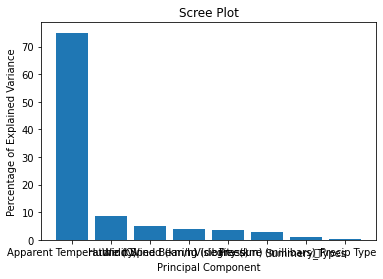

In [75]:
per_var = np.round(pca.explained_variance_ratio_* 100, decimals=1)
labels = final_cols
 
plt.bar(x=range(1,len(per_var)+1), height=per_var, tick_label=labels)
plt.ylabel('Percentage of Explained Variance')
plt.xlabel('Principal Component')
plt.title('Scree Plot')
plt.show()
 

__________________________________________________
* graph shows all the data variation along with features
------------------------------------------------------------------
* Apparent Temperature (C)=>  0.74996916
* Humidity                =>  0.08516663
* Wind Speed (km/h)       =>  0.04876736
* Wind Bearing (degrees)  =>  0.03774839
* Visibility (km)         =>  0.03643841
* Pressure (millibars)    =>  0.02720564
* Summery_Types           =>  0.01078606
* Precip Type             =>  0.00391834
---------------------------------------------------------------
 

* Therefor set PCA  n_components=3
----------------------------------
 * Can predict **Apparent temperature** for  given **humidity** 
 ---------------------------------------------------------------------------------------------------
 * Apparent Temperature (C)=> 0.74996916 <- high value
 

In [76]:
pca =PCA(n_components=3)
X_pca = pca.fit_transform(merge)

In [77]:
pca.explained_variance_ratio_

array([0.74996916, 0.08516663, 0.04876736])

c) Linear Regression Model
---------------------------

In [78]:
final_cols = ['Apparent Temperature (C)','Humidity','Wind Speed (km/h)']
dfinal = pd.DataFrame(data=X_pca, columns=final_cols)

In [79]:
dfinal.head(10)

,Apparent Temperature (C),Humidity,Wind Speed (km/h)
0,-2.914398,-0.227136,0.932884
1,-2.914575,-0.311906,0.916954
2,-0.912651,0.194026,-0.434658
3,-2.913513,-0.318911,0.904917
4,-0.914328,-0.311798,0.607982
5,-2.911900,-0.191592,0.847941
6,-2.897142,0.855753,1.055513
7,-2.899852,0.548642,1.064862
8,-2.904416,0.181597,0.635154
9,-2.909467,-0.335301,0.637936


In [80]:
from sklearn.model_selection import train_test_split

In [81]:
X = dfinal[['Humidity','Wind Speed (km/h)']]
y = dfinal['Apparent Temperature (C)']

In [82]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101)

In [83]:
from sklearn.linear_model import LinearRegression
lm = LinearRegression()
lm.fit(X_train,y_train)

LinearRegression()

In [84]:
print(lm.intercept_)

0.00204582800538291


In [85]:
coeff_df = pd.DataFrame(lm.coef_,X.columns,columns=['Coefficient'])
coeff_df

,Coefficient
Humidity,0.003942
Wind Speed (km/h),0.007267


In [86]:
predictions = lm.predict(X_test)

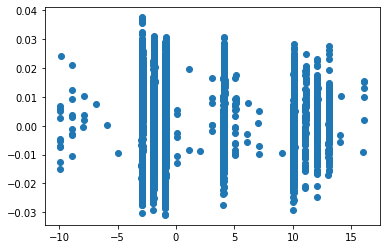

In [87]:
plt.scatter(y_test,predictions)

In [88]:
from sklearn import metrics
print('MAE:', metrics.mean_absolute_error(y_test, predictions))
print('MSE:', metrics.mean_squared_error(y_test, predictions))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, predictions)))

MAE: 3.1502275768380263
MSE: 18.22427216078705
RMSE: 4.26898959483237
